In [1]:
import json
import os
import math
from IPython.display import display
PROJECT_ROOT = os.path.abspath(os.path.join(os.getcwd(), "..", ".."))
os.chdir(PROJECT_ROOT)

In [2]:
os.getcwd()
from src.analysis.analyze_drive_lm import DriveLMAnalysis


In [3]:
drive_lm_train_file = "resources/data/drivelm/v1_1_train_nus.json"
with open(drive_lm_train_file, "r") as file:
    drive_lm_data = json.load(file)

In [4]:
drive_lm = DriveLMAnalysis(train_dict=drive_lm_data)

all_question_stat, per_scene_question_stat = drive_lm.process_analysis()

In [5]:
perception = []
prediction = []
planning = []
behavior = []

In [6]:
min, max

(<function min>, <function max>)

In [7]:
for k, v in all_question_stat.items():
    if "perception" in v:
        perception.append(v["perception"])
    if "prediction" in v:
        prediction.append(v["prediction"])
    if "planning" in v:
        planning.append(v["planning"])
    if "behavior" in v:
        behavior.append(v["behavior"])


In [8]:
min, max = drive_lm.find_min_max_value([perception, prediction, planning, behavior])

min, max

(1, 74)

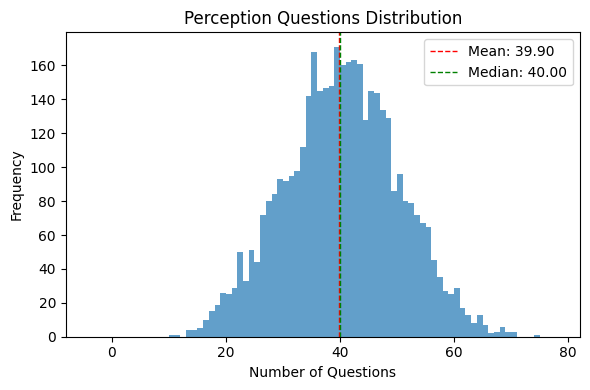

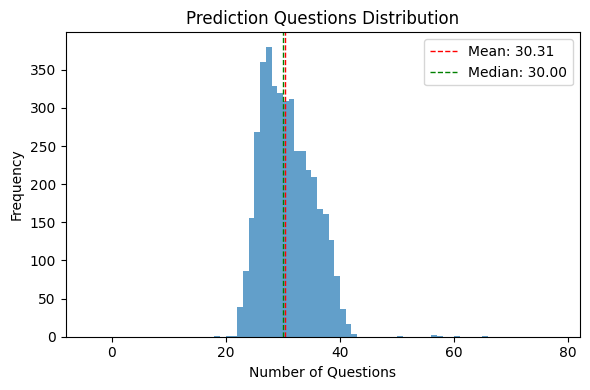

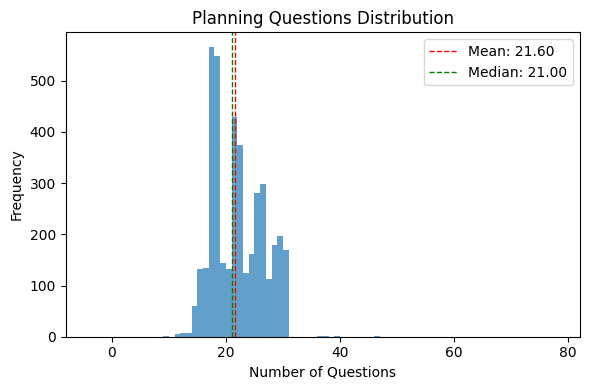

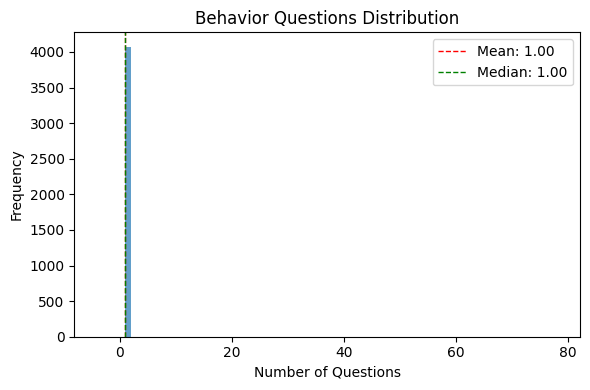

In [9]:
drive_lm.plot_list_distribution(values=perception, title="Perception Questions Distribution", min_=min, max_=max)
drive_lm.plot_list_distribution(values=prediction, title="Prediction Questions Distribution", min_=min, max_=max)
drive_lm.plot_list_distribution(values=planning, title="Planning Questions Distribution", min_=min, max_=max)
drive_lm.plot_list_distribution(values=behavior, title="Behavior Questions Distribution", min_=min, max_=max)

/Users/rohitupadhya/Desktop/bosch/code/driveLM-RAG/src/analysis/analyze_drive_lm.py:263: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[0].set_xticklabels(names, rotation=45, ha="right")
/Users/rohitupadhya/Desktop/bosch/code/driveLM-RAG/src/analysis/analyze_drive_lm.py:268: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[1].set_xticklabels(names, rotation=45, ha="right")
/Users/rohitupadhya/Desktop/bosch/code/driveLM-RAG/src/analysis/analyze_drive_lm.py:273: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[2].set_xticklabels(names, rotation=45, ha="right")


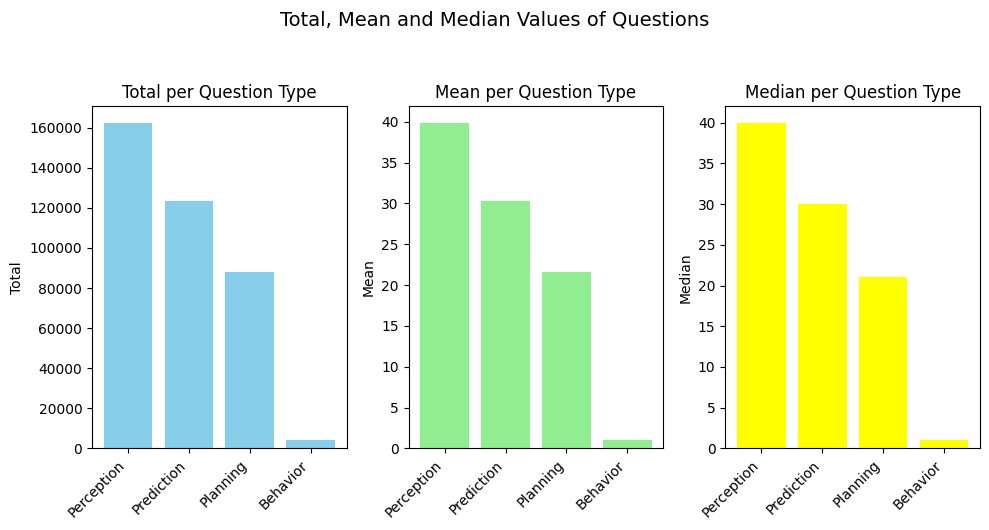

In [10]:
drive_lm.plot_total(heading="Total, Mean and Median Values of Questions", lists_dict={
    "Perception": perception,
    "Prediction": prediction,
    "Planning": planning,
    "Behavior": behavior,
})

In [11]:
per_scene_perception = []
per_scene_prediction = []
per_scene_planning = []
per_scene_behavior = []

In [12]:
for k, v in per_scene_question_stat.items():
    if "perception" in v:
        per_scene_perception.append(v["perception"])
    if "prediction" in v:
        per_scene_prediction.append(v["prediction"])
    if "planning" in v:
        per_scene_planning.append(v["planning"])
    if "behavior" in v:
        per_scene_behavior.append(v["behavior"])

In [13]:
min, max = drive_lm.find_min_max_value([per_scene_perception, per_scene_prediction, per_scene_planning, per_scene_behavior])

min, max

(4, 520)

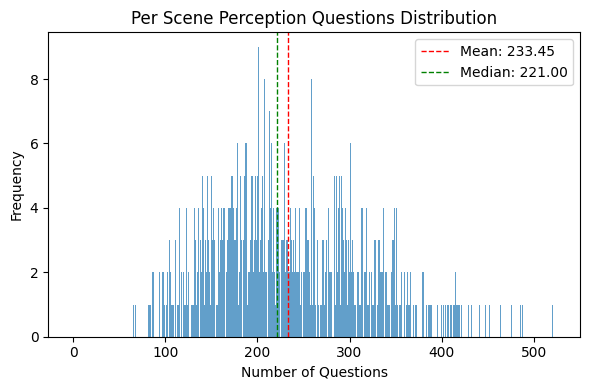

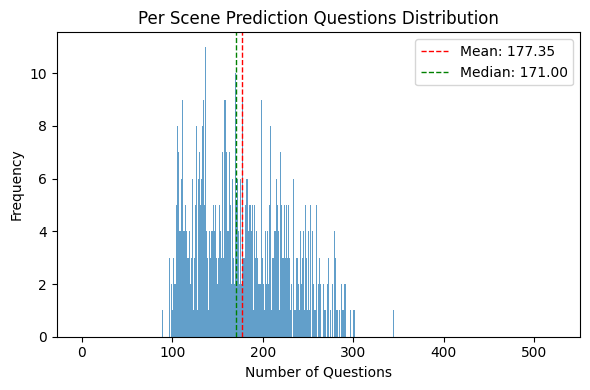

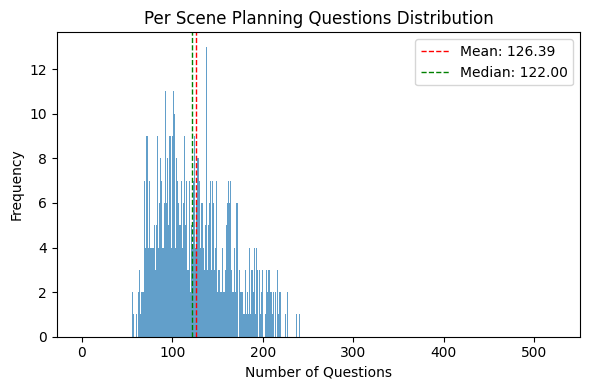

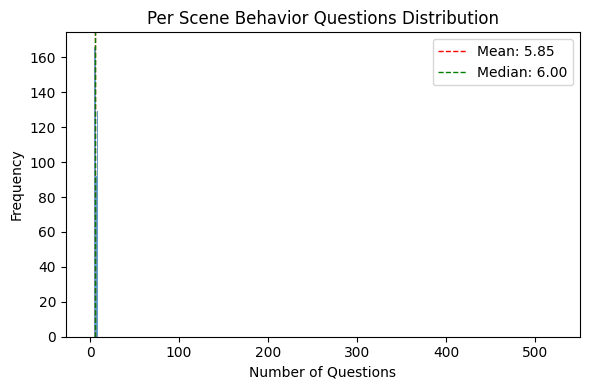

In [14]:
drive_lm.plot_list_distribution(values=per_scene_perception, title="Per Scene Perception Questions Distribution", min_=min, max_=max)
drive_lm.plot_list_distribution(values=per_scene_prediction, title="Per Scene Prediction Questions Distribution", min_=min, max_=max)
drive_lm.plot_list_distribution(values=per_scene_planning, title="Per Scene Planning Questions Distribution", min_=min, max_=max)
drive_lm.plot_list_distribution(values=per_scene_behavior, title="Per Scene Behavior Questions Distribution", min_=min, max_=max)

/Users/rohitupadhya/Desktop/bosch/code/driveLM-RAG/src/analysis/analyze_drive_lm.py:263: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[0].set_xticklabels(names, rotation=45, ha="right")
/Users/rohitupadhya/Desktop/bosch/code/driveLM-RAG/src/analysis/analyze_drive_lm.py:268: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[1].set_xticklabels(names, rotation=45, ha="right")
/Users/rohitupadhya/Desktop/bosch/code/driveLM-RAG/src/analysis/analyze_drive_lm.py:273: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[2].set_xticklabels(names, rotation=45, ha="right")


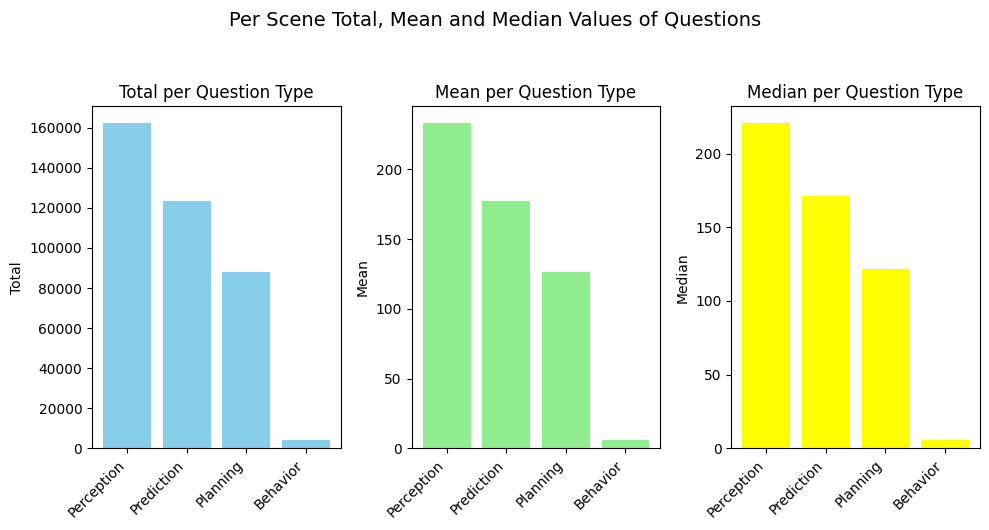

In [15]:
drive_lm.plot_total(heading="Per Scene Total, Mean and Median Values of Questions", lists_dict={
    "Perception": per_scene_perception,
    "Prediction": per_scene_prediction,
    "Planning": per_scene_planning,
    "Behavior": per_scene_behavior,
})

CAM_FRONT: 1 boxes


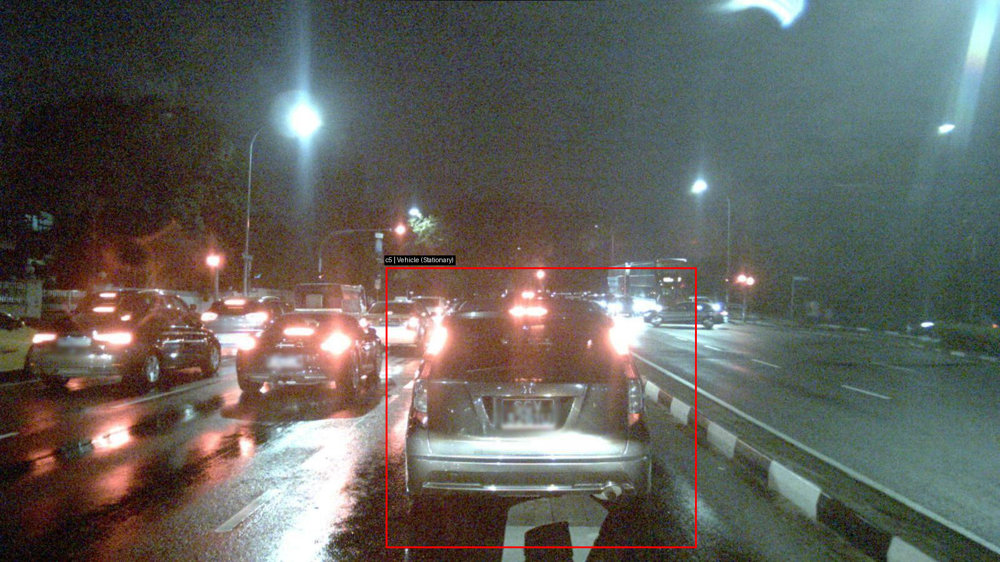

CAM_FRONT_LEFT: 1 boxes


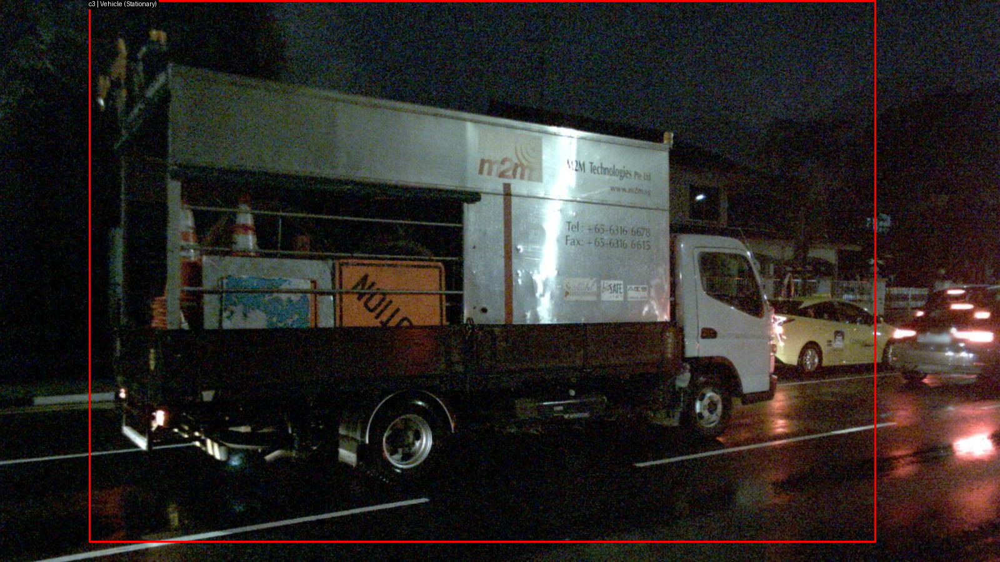

CAM_FRONT_RIGHT: 0 boxes


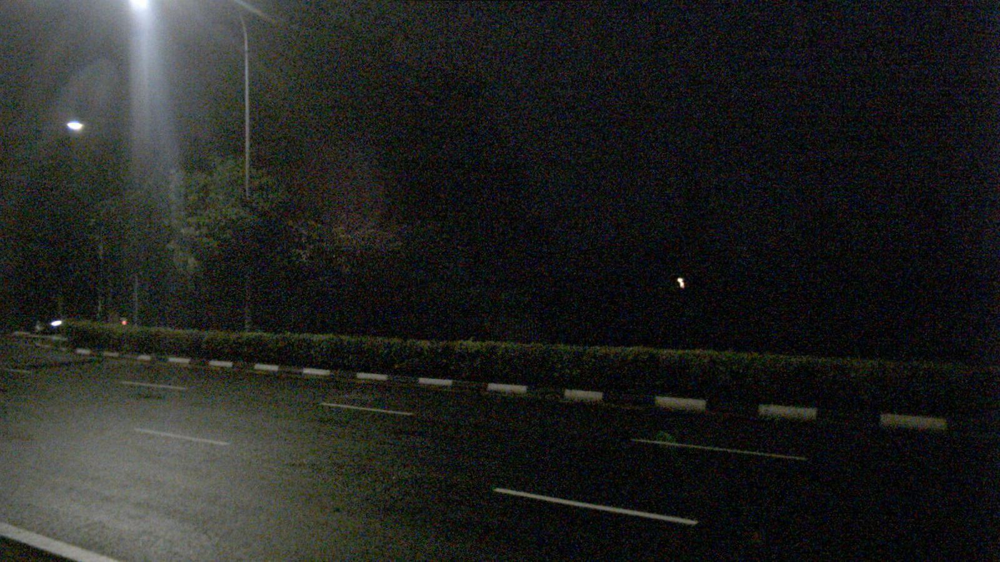

CAM_BACK: 2 boxes


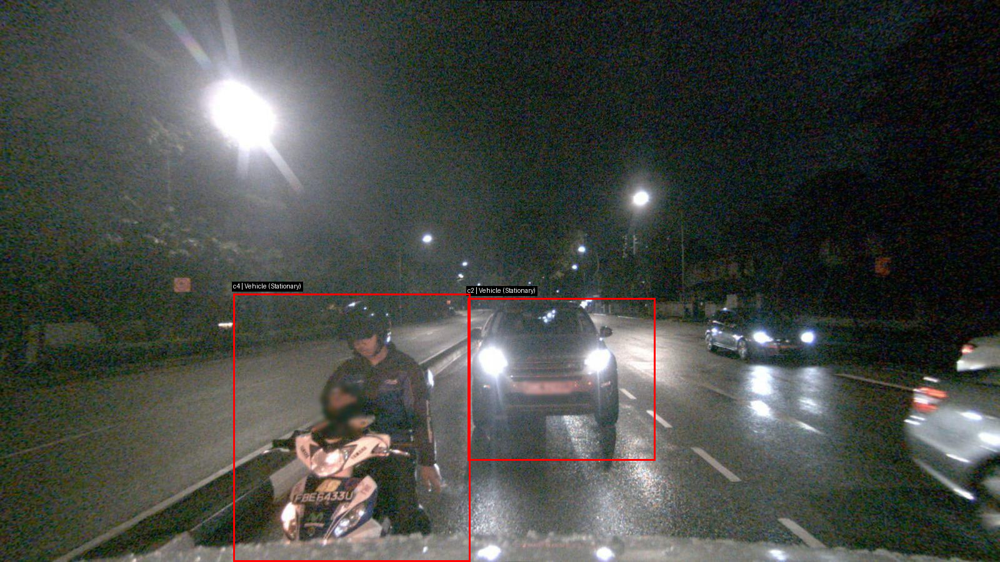

CAM_BACK_LEFT: 1 boxes


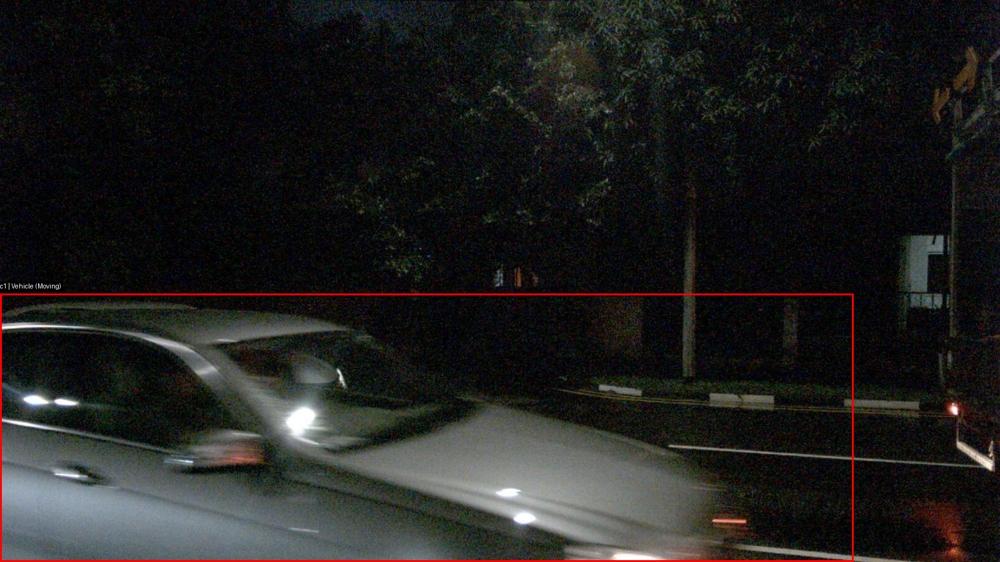

CAM_BACK_RIGHT: 0 boxes


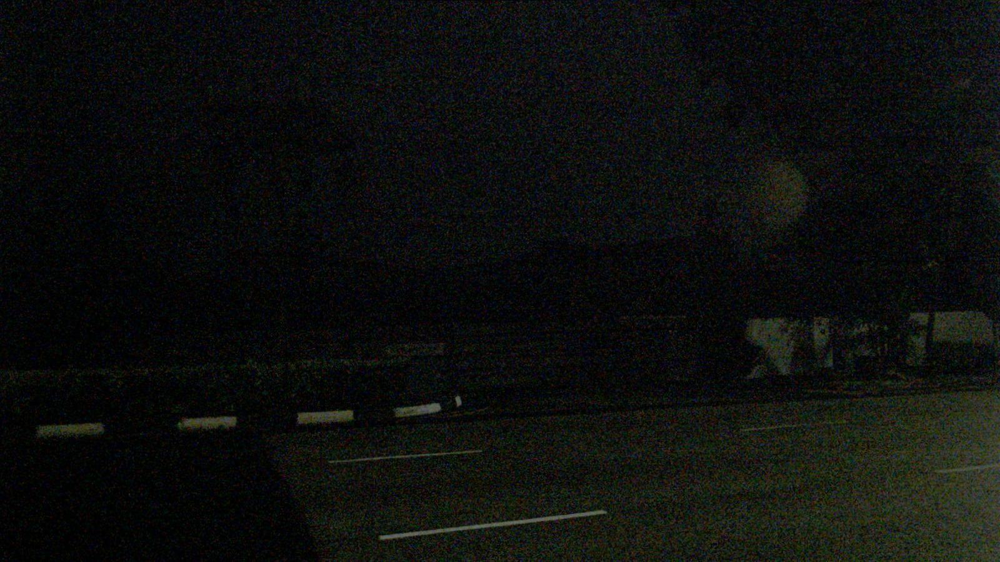

In [16]:
visualize_samples = drive_lm.visualize_sample()

if visualize_samples:
    for cam, payload in visualize_samples.items():
        print(f"{cam}: {len(payload['boxes'])} boxes")
        display(payload["image"])